In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
from matplotlib import gridspec 


In [2]:
import pandas as pd
data = pd.read_csv("documents//creditcard.csv") 


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

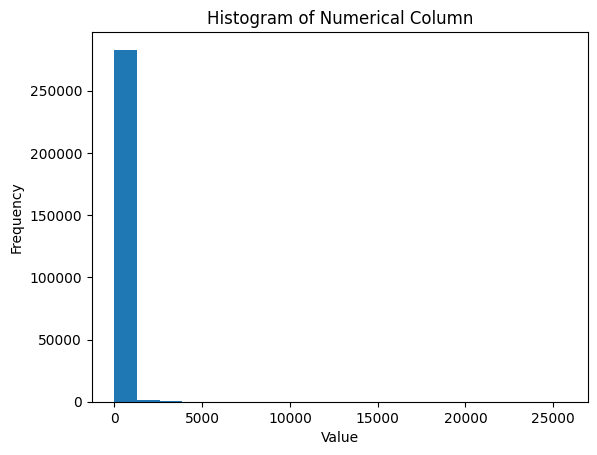

In [5]:
import matplotlib.pyplot as plt
plt.hist(data['Amount'], bins=20)
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram of Numerical Column')
plt.show()

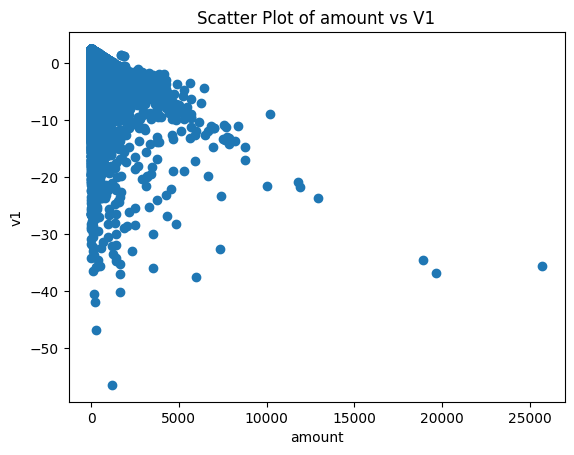

In [12]:
plt.scatter(data['Amount'], data['V1'])
plt.xlabel('amount')
plt.ylabel('v1')
plt.title('Scatter Plot of amount vs V1')
plt.show()

In [14]:
sns.pairplot(data)
plt.title('Pair Plot of Numerical Variables')
plt.show()

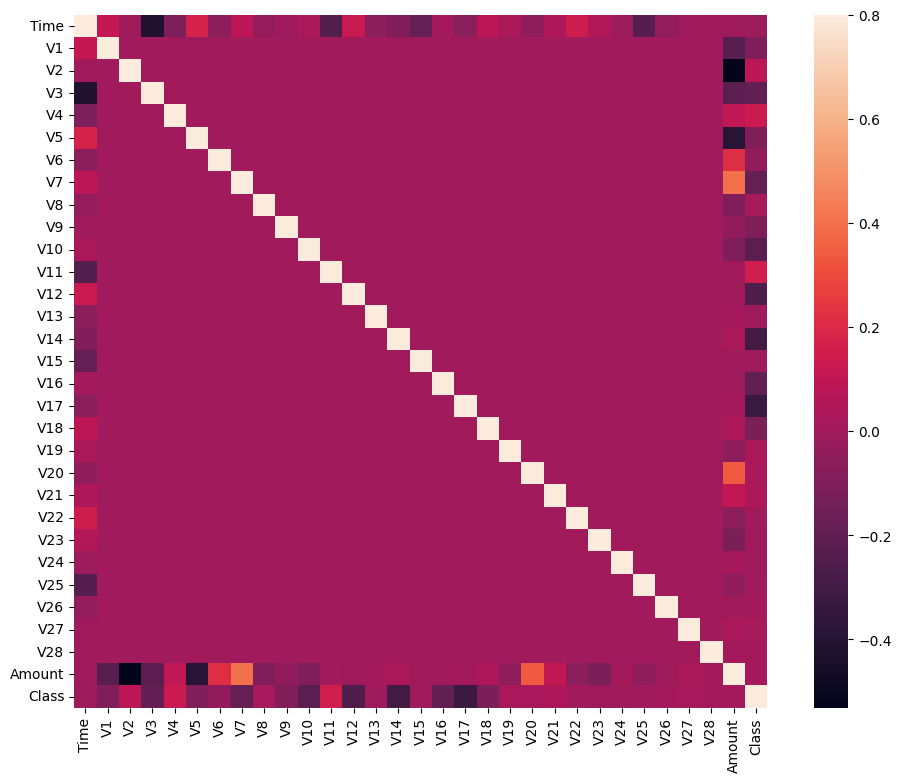

In [15]:
corrmat = data.corr() 

fig = plt.figure(figsize = (12, 9)) 

sns.heatmap(corrmat, vmax = .8, square = True) 
plt.show()

C:\Users\91948\AppData\Local\Temp\ipykernel_24468\500123209.py:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  p1=sns.kdeplot(data['Amount'], shade=True, color="r")


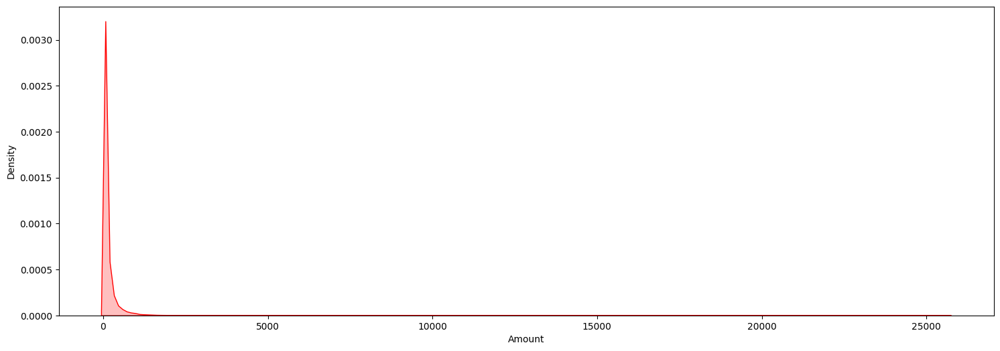

In [16]:
plt.figure(figsize=(18,6))
sorted_data = data.sort_values(by='Amount', ascending=True)
p1=sns.kdeplot(data['Amount'], shade=True, color="r")

The total amount of fraudulent transactions:  60127.96999999997
The total number of fraudulent transactions:  492
The total amount of non-fraudulent transactions:  25102462.039983638
The total number of fraudulent transactions:  284315


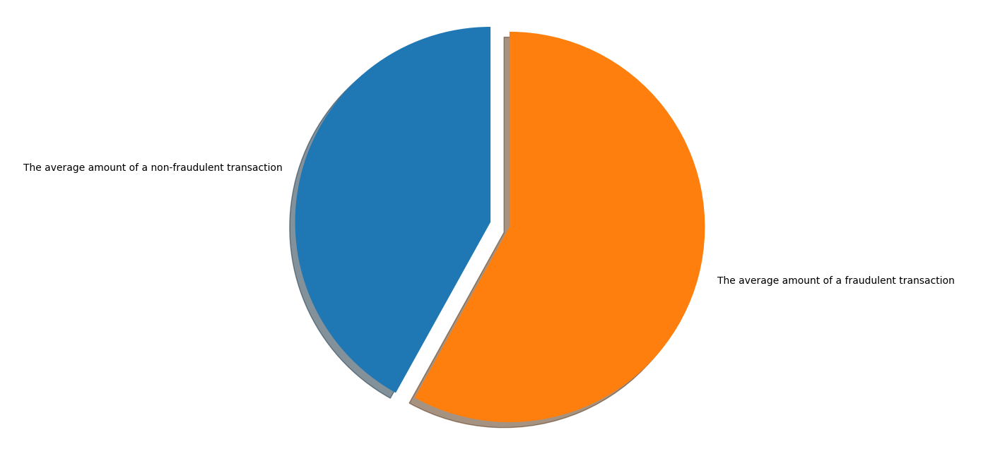

In [17]:
fraudulent_amount = 0
number_of_fraudulent_transactions = 0;
for record in data.itertuples():
    if record.Class == True:
        fraudulent_amount += record.Amount
        number_of_fraudulent_transactions += 1
print('The total amount of fraudulent transactions: ', fraudulent_amount)    
print('The total number of fraudulent transactions: ', number_of_fraudulent_transactions)  
fraudulent_mean = fraudulent_amount / number_of_fraudulent_transactions
        
nonfraudulent_amount = 0
number_of_nonfraudulent_transactions = 0
for record in data.itertuples():
    if record.Class == False:
        nonfraudulent_amount += record.Amount
        number_of_nonfraudulent_transactions += 1
print('The total amount of non-fraudulent transactions: ', nonfraudulent_amount)    
print('The total number of fraudulent transactions: ', number_of_nonfraudulent_transactions)  
nonfraudulent_mean = nonfraudulent_amount / number_of_nonfraudulent_transactions
        
d = {'Class':[0, 1], 'Mean':[nonfraudulent_mean, fraudulent_mean]}

fig, ax = plt.subplots(figsize=(18,8))
ax.pie(d["Mean"],
       explode=[0, 0.1],
       labels=['The average amount of a non-fraudulent transaction', 'The average amount of a fraudulent transaction'],
       shadow=True, startangle=90)

ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

<Axes: >

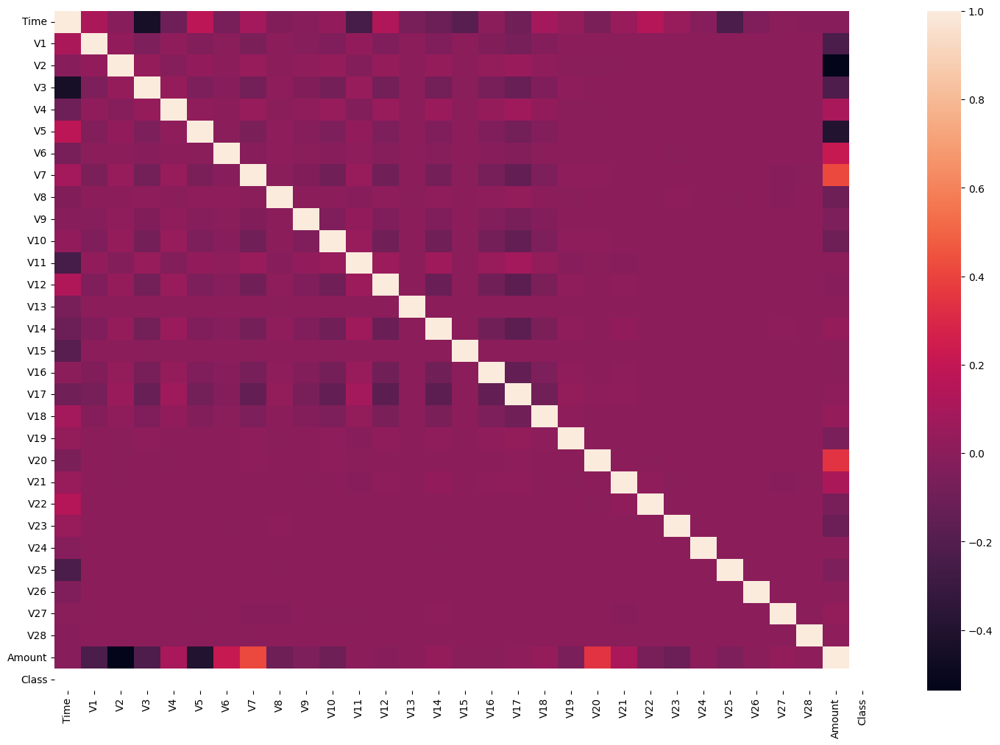

In [18]:
nonfraudulent_data = data[data["Class"] == 0]
correlated_data = nonfraudulent_data.corr()

plt.figure(figsize=(18,12))
sns.heatmap(correlated_data, annot=False)

C:\Users\91948\AppData\Local\Temp\ipykernel_24468\846387829.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  plot = sns.distplot(a=data["Time"], kde=True, color='purple')


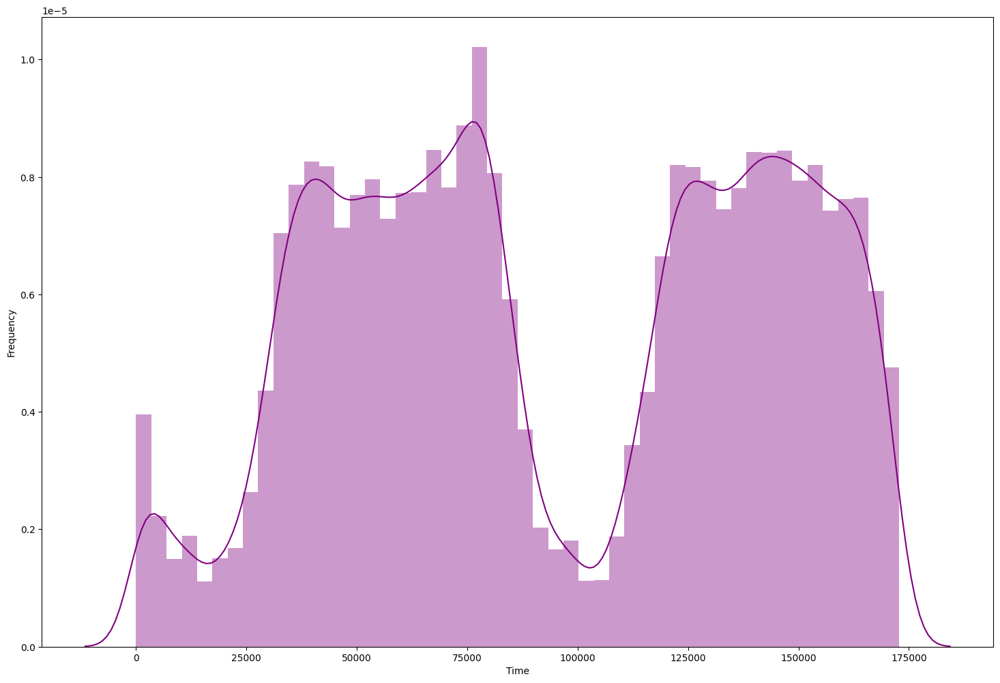

In [19]:
plt.figure(figsize=(18,12))
plot = sns.distplot(a=data["Time"], kde=True, color='purple')
plot.set(xlabel ='Time', ylabel ='Frequency')
plt.show()

<Figure size 1800x800 with 0 Axes>

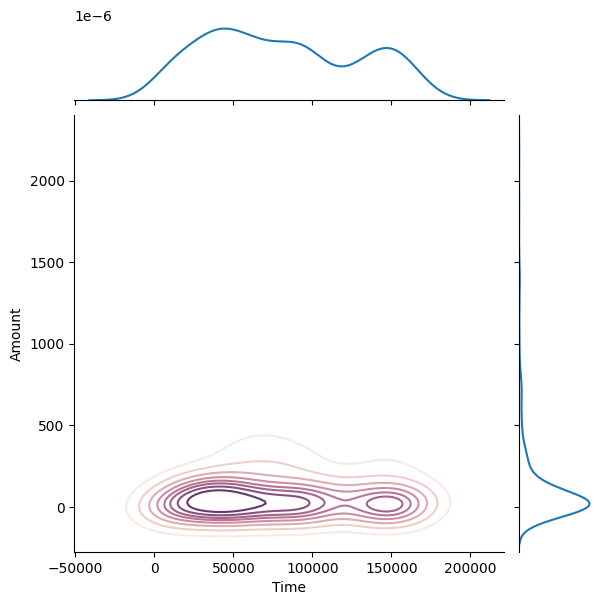

In [20]:
plt.figure(figsize=(18,8))

fraudulent_transactions = data[data['Class'] == 1]

cmap = sns.cubehelix_palette(light=1, as_cmap=True) 
sns.jointplot(x=fraudulent_transactions["Time"], y=fraudulent_transactions["Amount"], cmap=cmap, kind="kde")

<Axes: xlabel='Time', ylabel='Amount'>

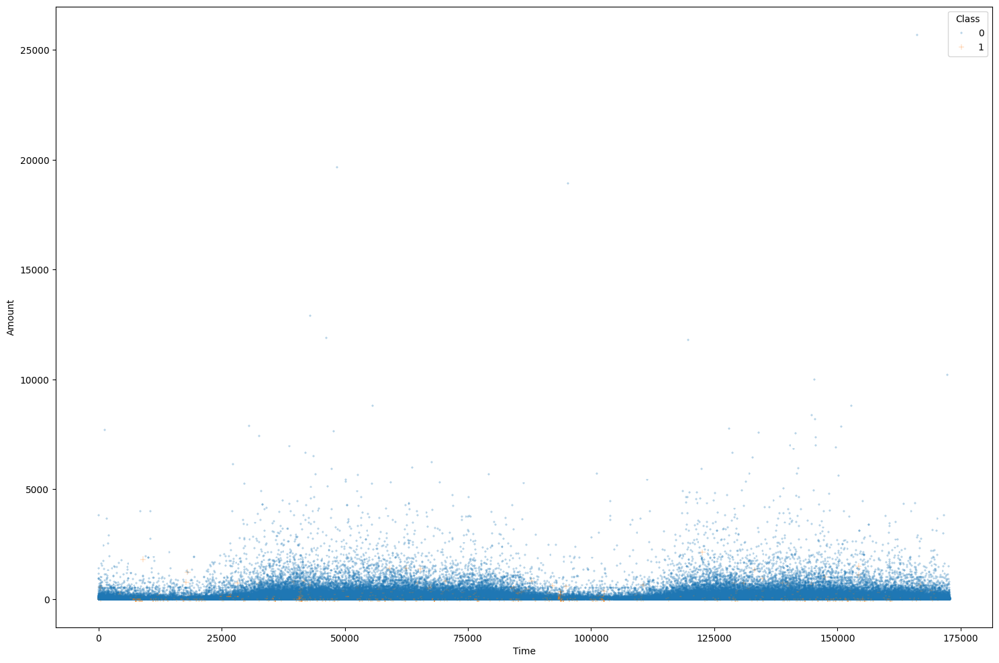

In [21]:
plt.figure(figsize=(18,12))
sns.scatterplot(x=data["Time"], y=data["Amount"], hue=data["Class"], size=data["Class"], sizes=(40, 8), marker="+")

C:\Users\91948\AppData\Local\Temp\ipykernel_24468\851091387.py:4: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  plot = sns.kdeplot(data=fraudulent_transactions["Amount"], label="Fraud", shade=True, color='orange')


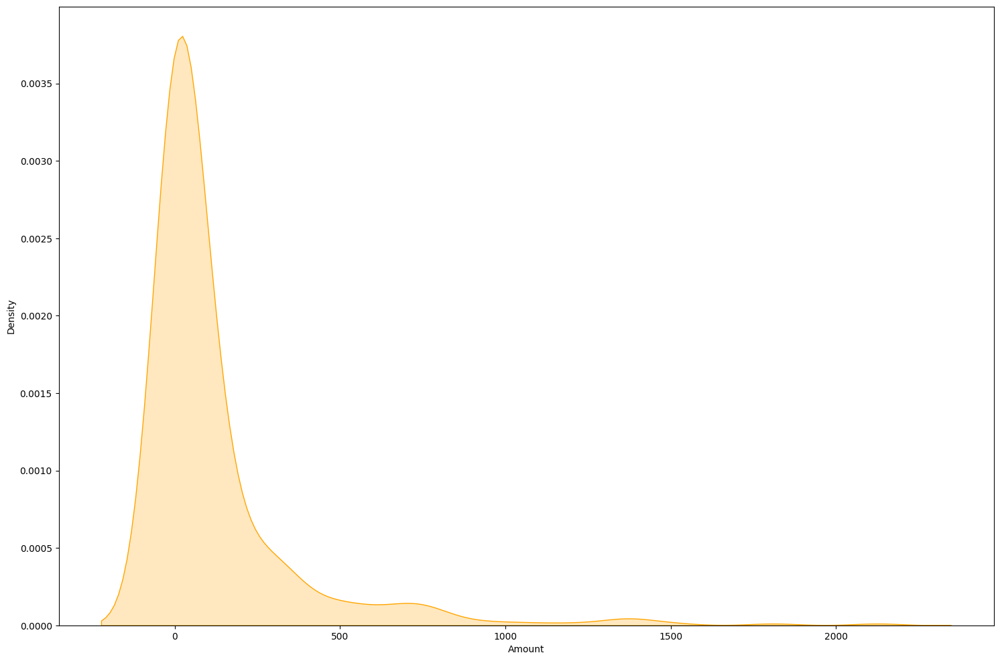

In [22]:
plt.figure(figsize=(18,12))

fraudulent_transactions = data[data['Class'] == 1]
plot = sns.kdeplot(data=fraudulent_transactions["Amount"], label="Fraud", shade=True, color='orange')
plot.set(xlabel ='Amount', ylabel ='Density')
plt.show()